<a href="https://colab.research.google.com/github/serendipity109/TF-Net/blob/master/TF_Net_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# This is a simple demonstrative notebook for the pretrained TF-Net

In [ ]:
!pip install torch==1.7.1

In [ ]:
!git clone https://github.com/serendipity109/TF-Net

Cloning into 'TF-Net'...
remote: Enumerating objects: 106, done.
remote: Counting objects: 100% (106/106), done.
remote: Compressing objects: 100% (95/95), done.
remote: Total 106 (delta 10), reused 100 (delta 8), pack-reused 0
Receiving objects: 100% (106/106), 53.12 MiB | 33.19 MiB/s, done.
Resolving deltas: 100% (10/10), done.


In [ ]:
import os
os.chdir('./TF-Net')
def ifmake(pth):
  if not os.path.exists(pth):
      os.makedirs(pth)
for f1 in ['frames', 'faces']:
  ifmake('./' + f1)
  for f2 in ['real', 'fake']:
    ifmake('./' + f1 + '/' + f2)

In [ ]:
!gdown --id '1pB-lhwVNDMa_iYg4HJf_Pz1_upV78d-C' --output video.tar && gdown --id '1PGMU8H6mR6MzBTPbMdVQnMwR9NgBju_s' --output frame.tar

Downloading...
From: https://drive.google.com/uc?id=1pB-lhwVNDMa_iYg4HJf_Pz1_upV78d-C
To: /content/TF-Net/video.tar
167MB [00:01, 141MB/s]
Downloading...
From: https://drive.google.com/uc?id=1PGMU8H6mR6MzBTPbMdVQnMwR9NgBju_s
To: /content/TF-Net/frame.tar
167MB [00:01, 164MB/s] 


# Frames Extraction

In [ ]:
import cv2
import os
from tqdm.notebook import tqdm
sources = ['real', 'fake']
for source in sources:
  inp = f'./{source}.mp4'
  out = f'./frames/{source}'
  def capture(inp, out):
      cap = cv2.VideoCapture(inp)
      frameId = 0
      for i in tqdm(range(1000)):
          frameId = cap.get(1)  # current frame number
          ret, frame = cap.read()
          if not ret:
              break
          filename = os.path.join(out, inp.split('/')[-1].split('.mp4')[0] + '_' + str(int(frameId + 1)) + ".jpg")
          cv2.imwrite(filename, frame) 
  capture(inp, out)


59.94005994005994



23.976023976023978


# Faces Extraction

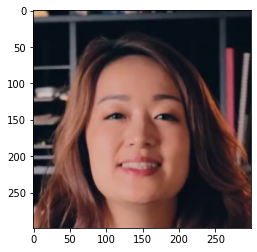

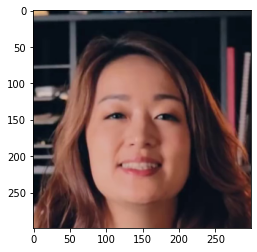

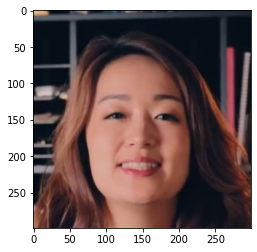

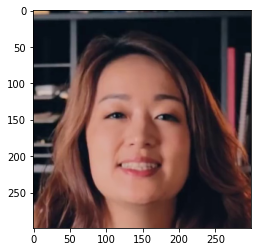

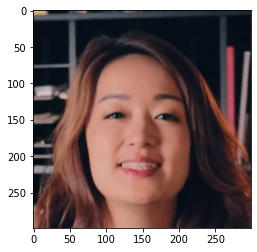

...

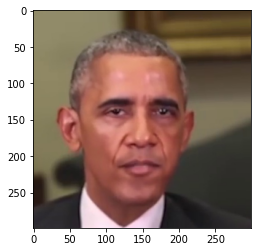

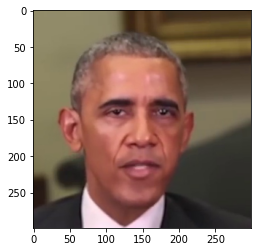

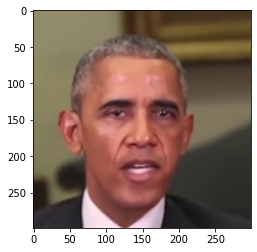

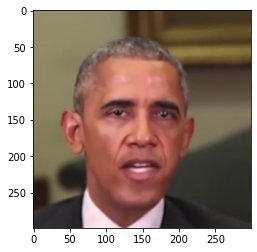

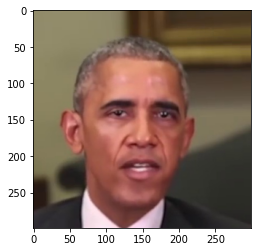

In [ ]:
os.chdir('./demo_code')
from retinaface.detector import RetinafaceDetector
from utils import align_face
from skimage.io import imread, imsave
import matplotlib.pyplot as plt
def extract(pth):
    img = imread(pth)
    detector = RetinafaceDetector(net='mnet', type = 'cuda') 
    bboxes, landmarks = detector.detect_faces(img)
    if len(landmarks) > 0:
        for i in range(len(landmarks)):
            bbox, landms = bboxes[i], landmarks[i]
            out_img = align_face(img, [landms])
            plt.imshow(out_img)
            plt.show()
            imsave(pth.replace('frames', 'faces'), out_img)
using = dict(); using['real'] = [1, 200]; using['fake'] = [200, 300]
for k, v in using.items():
  for idx in range(v[0], v[1]):
    extract(f'../frames/{k}/{k}_{idx}.jpg')

# DeepFake Determination

In [ ]:
source = 'fake'
import warnings
warnings.filterwarnings('ignore')
from imageio import imread
import torch
from torchvision import transforms
import os
folder = f'../faces/{source}'
transform = transforms.Compose([
  transforms.ToPILImage(),
  transforms.Resize((299, 299)),
  transforms.ToTensor(),
  transforms.Normalize(mean = (0.5, 0.5, 0.5), std = (0.5, 0.5, 0.5))
])
img = torch.cat([transform(imread(os.path.join(folder, v))).view(1,3,299,299) for v in list(f'{source}_{num}.jpg' for num in range(using[source][0], using[source][1]))])
from model.__init__ import *
pths = ['../video.tar', '../frame.tar']
for pth in pths:
    frame = 'frame' in pth
    md = model(template=True, dct = True, frame = frame)
    md = load_partial_pth(pth, md)
    md = md.cuda(); md.eval()
    SEED = 0
    torch.manual_seed(SEED)
    torch.cuda.manual_seed(SEED)
    img = img.cuda()
    md = md.cuda()
    md.eval()
    with torch.no_grad():
        p, pmask = md(img)
    if not frame:
        print('Probability:', p.item()) # the probability of being manipulated

Probability: 0.5312517881393433


Probability: 0.5092449188232422


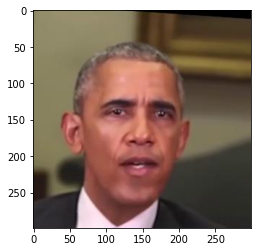

Probability: 0.5150620341300964


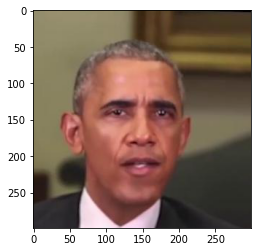

Probability: 0.5181460380554199


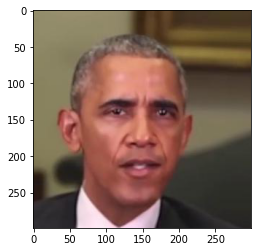

Probability: 0.5194719433784485


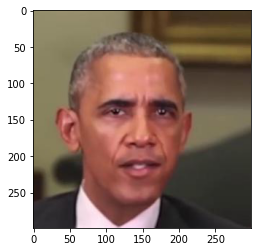

Probability: 0.5200126767158508


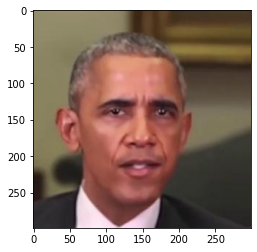

Probability: 0.519817590713501


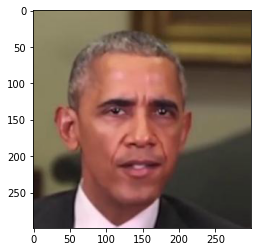

Probability: 0.5181513428688049


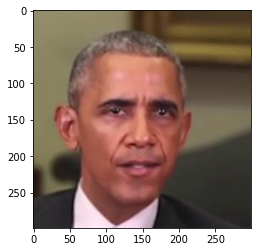

Probability: 0.5140929222106934


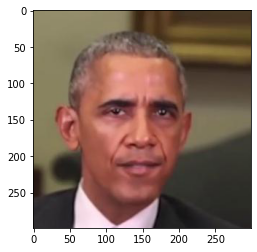

Probability: 0.5088911652565002


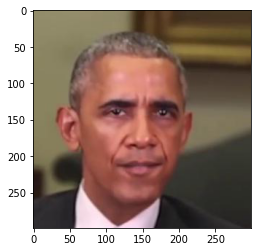

Probability: 0.5036659836769104


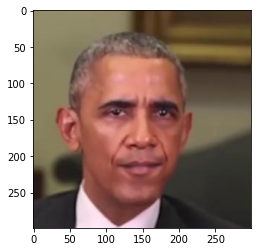

Probability: 0.4985055923461914


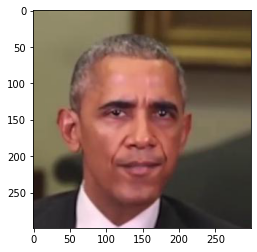

Probability: 0.4937628507614136


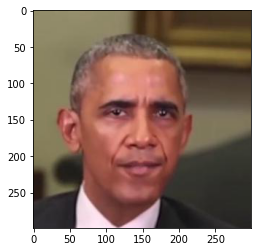

Probability: 0.4899017810821533


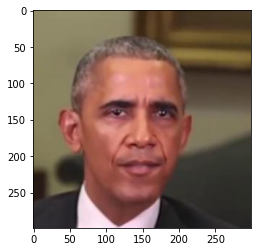

Probability: 0.48680567741394043


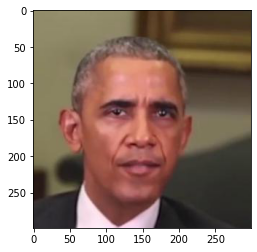

Probability: 0.48436209559440613


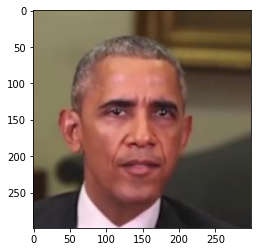

Probability: 0.48309987783432007


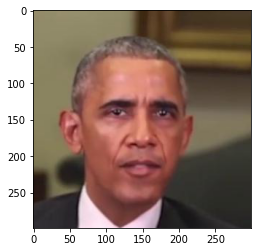

Probability: 0.48406654596328735


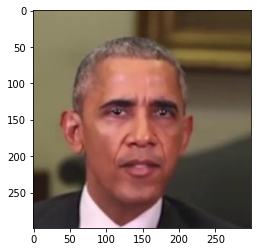

Probability: 0.4876532256603241


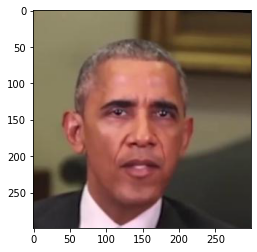

Probability: 0.4943873882293701


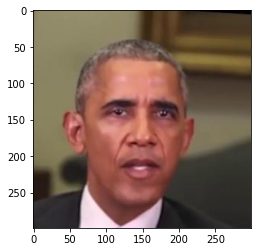

Probability: 0.5021384358406067


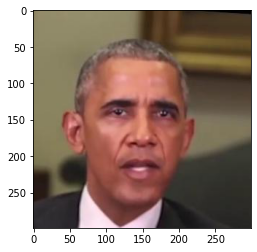

Probability: 0.5123308300971985


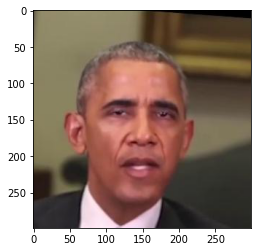

Probability: 0.5223511457443237


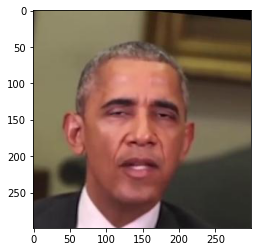

Probability: 0.530791163444519


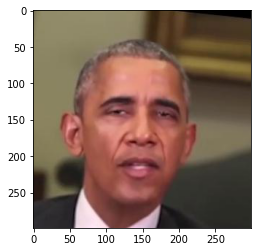

Probability: 0.5376086831092834


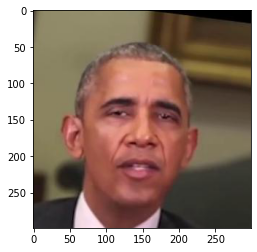

Probability: 0.5425124168395996


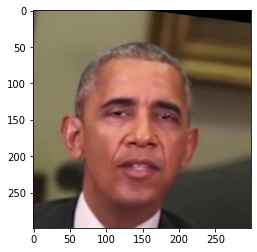

Probability: 0.5450411438941956


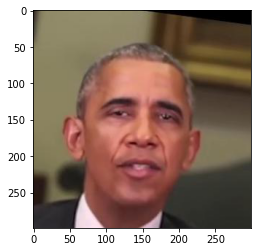

Probability: 0.5467139482498169


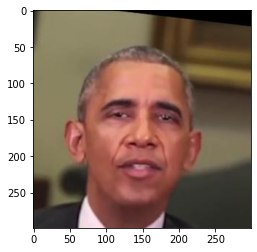

Probability: 0.5466855764389038


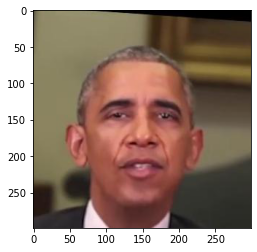

Probability: 0.545587420463562


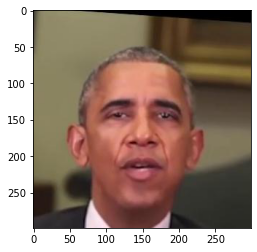

Probability: 0.543519914150238


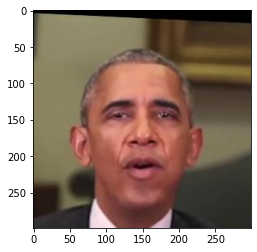

Probability: 0.5413902997970581


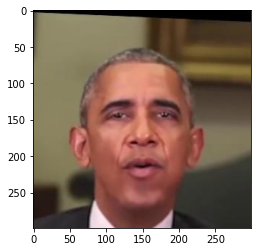

Probability: 0.5393089652061462


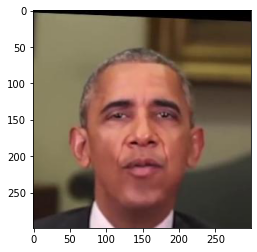

Probability: 0.5375826358795166


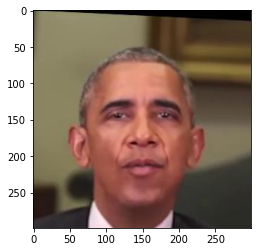

Probability: 0.5354074835777283


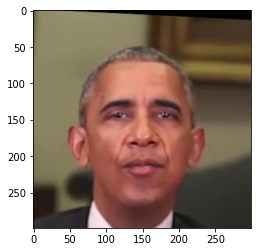

Probability: 0.5349989533424377


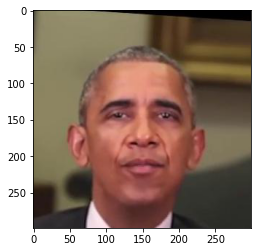

Probability: 0.5348973274230957


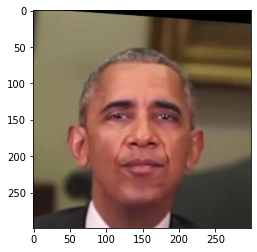

Probability: 0.5352025032043457


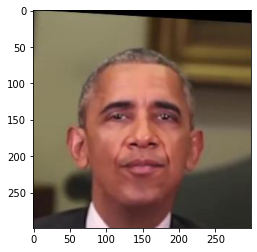

Probability: 0.5355163812637329


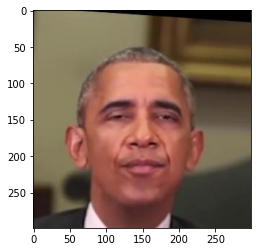

Probability: 0.5364823341369629


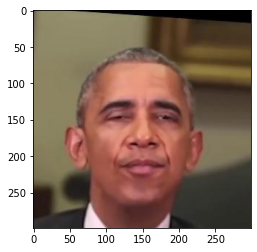

Probability: 0.5372966527938843


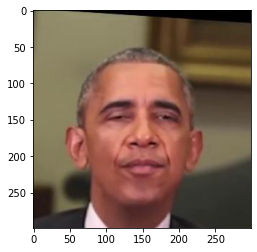

Probability: 0.5379710793495178


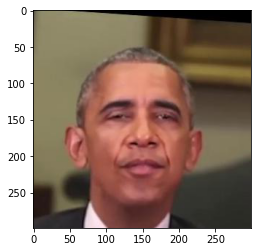

Probability: 0.5380918979644775


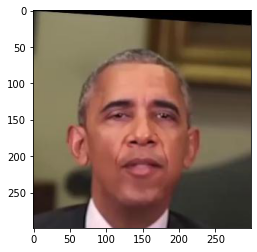

Probability: 0.5380701422691345


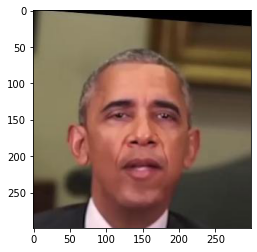

Probability: 0.5375410318374634


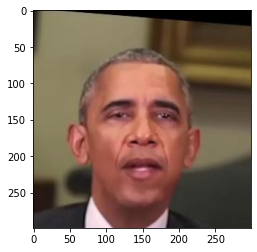

Probability: 0.5365481972694397


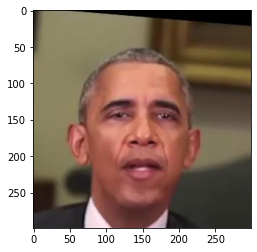

Probability: 0.5356010794639587


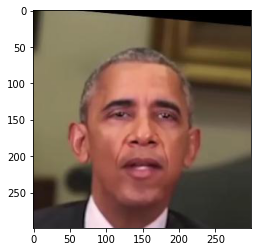

Probability: 0.5341706871986389


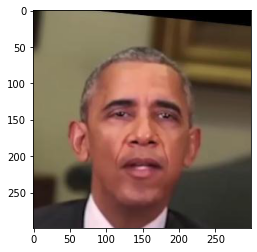

Probability: 0.5325109958648682


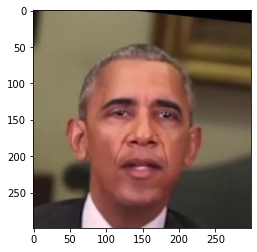

Probability: 0.5317888259887695


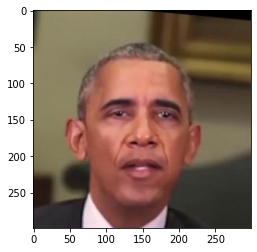

Probability: 0.5316380262374878


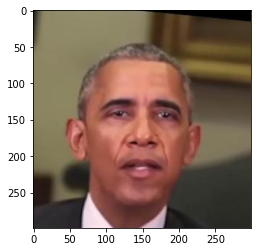

Probability: 0.5319237112998962


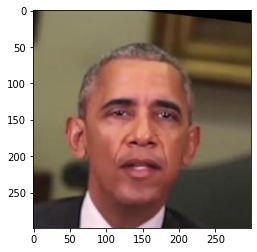

Probability: 0.5319643020629883


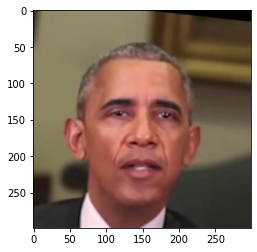

Probability: 0.5320134162902832


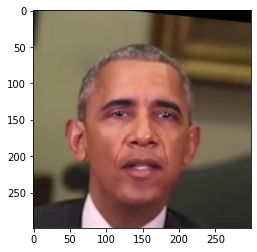

Probability: 0.5332757234573364


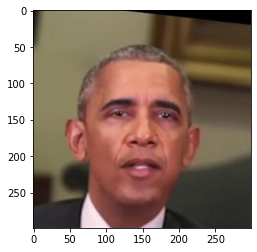

Probability: 0.5344043970108032


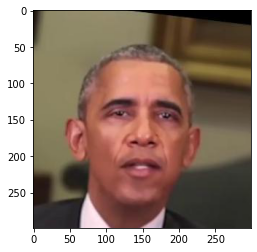

Probability: 0.5346245765686035


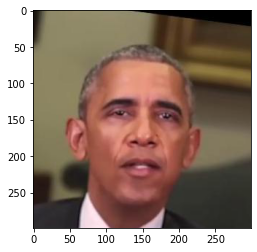

Probability: 0.5340885519981384


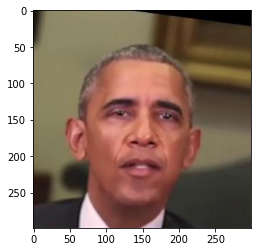

Probability: 0.5323653221130371


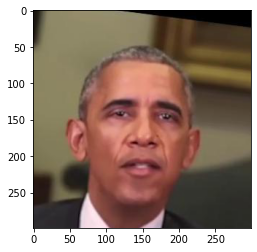

Probability: 0.5302911400794983


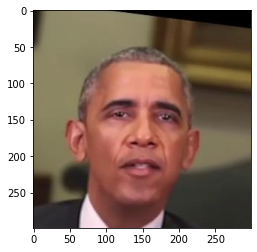

Probability: 0.5281152129173279


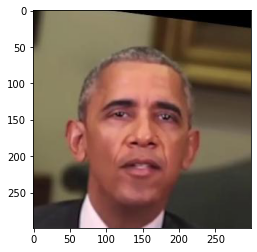

Probability: 0.5272048115730286


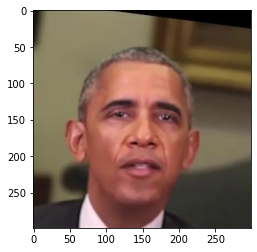

Probability: 0.5292831063270569


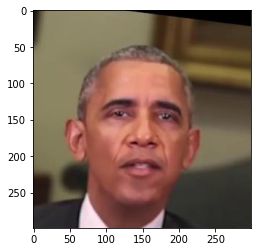

Probability: 0.5324341058731079


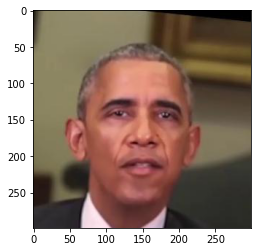

Probability: 0.5365242958068848


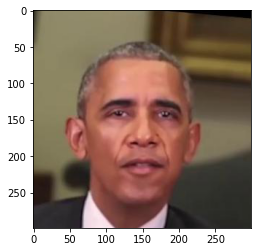

Probability: 0.5411214232444763


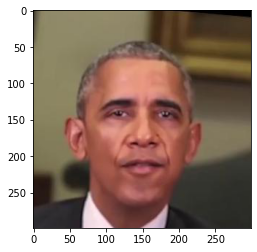

Probability: 0.5459992289543152


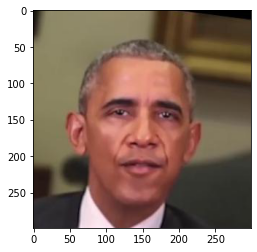

Probability: 0.5505113005638123


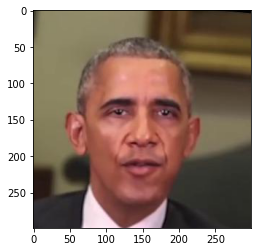

Probability: 0.5547704100608826


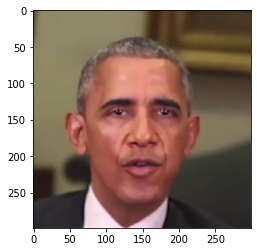

Probability: 0.5583993792533875


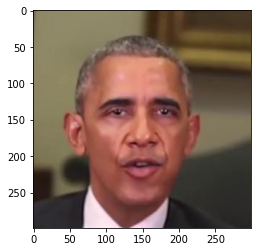

Probability: 0.5616501569747925


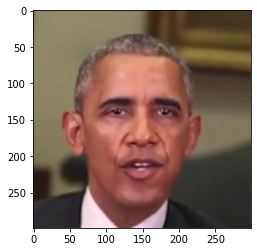

Probability: 0.5644383430480957


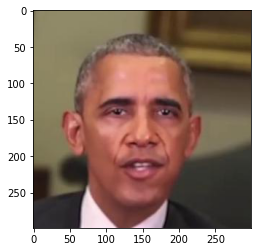

Probability: 0.5668805241584778


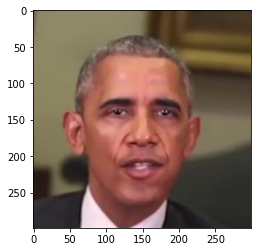

Probability: 0.5692776441574097


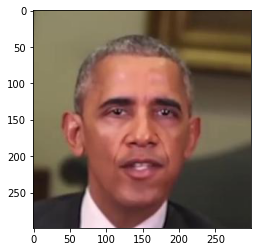

Probability: 0.571408748626709


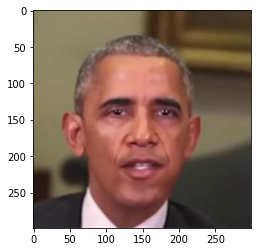

Probability: 0.5735151767730713


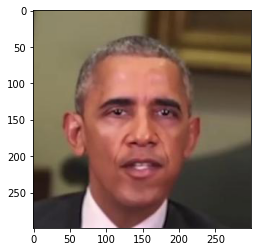

Probability: 0.5758329033851624


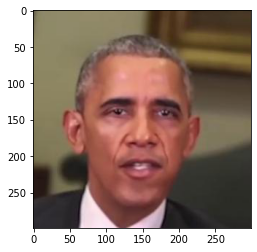

Probability: 0.5779982209205627


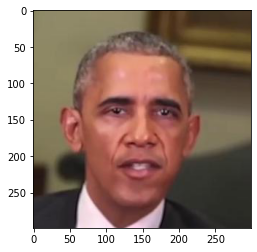

Probability: 0.5799745321273804


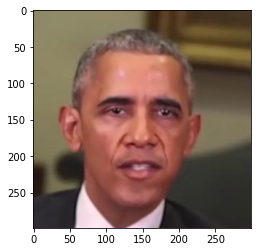

Probability: 0.5810804963111877


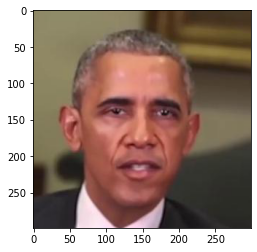

Probability: 0.5817782282829285


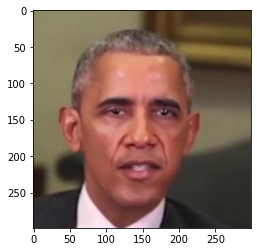

Probability: 0.5812885165214539


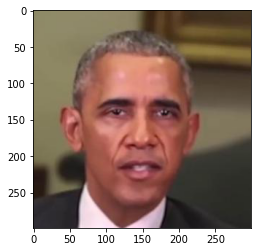

Probability: 0.5798294544219971


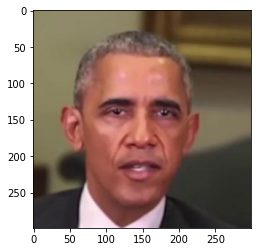

Probability: 0.5769516825675964


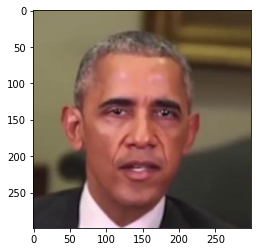

Probability: 0.5727314949035645


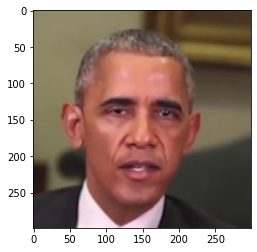

Probability: 0.5678203105926514


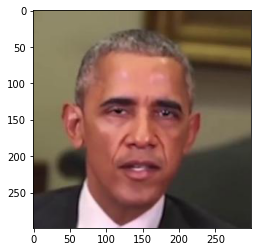

Probability: 0.5617944598197937


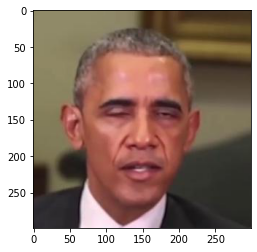

Probability: 0.5563054084777832


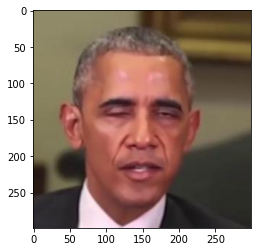

Probability: 0.5522090792655945


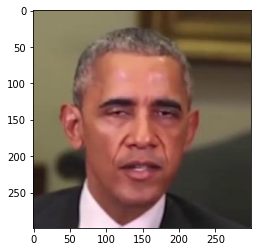

Probability: 0.5497580766677856


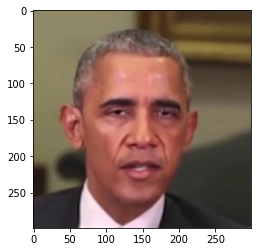

Probability: 0.5489840507507324


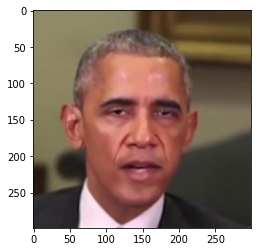

Probability: 0.5509170293807983


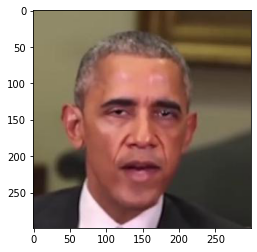

Probability: 0.5544000864028931


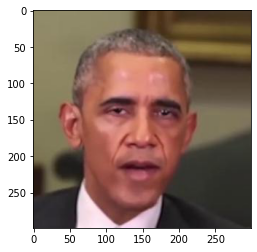

Probability: 0.5601031184196472


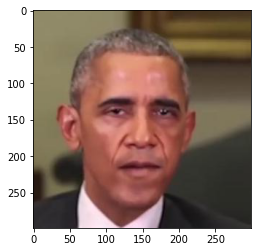

Probability: 0.565524160861969


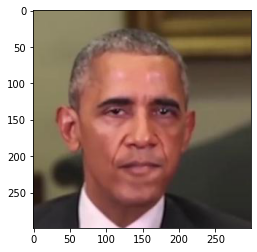

Probability: 0.5697766542434692


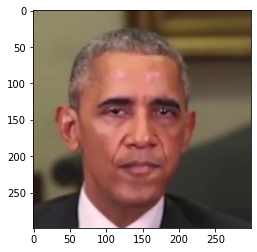

Probability: 0.571572482585907


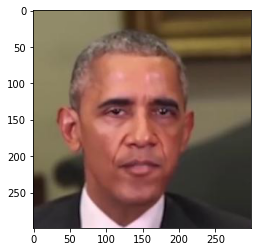

Probability: 0.5705310106277466


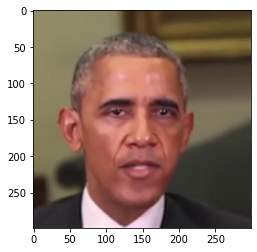

Probability: 0.5674455761909485


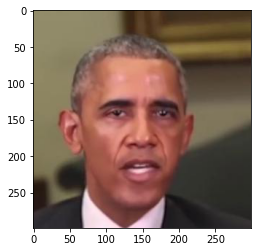

Probability: 0.5620501637458801


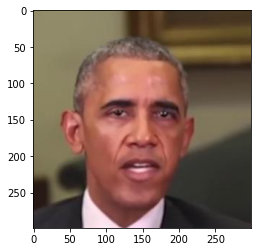

Probability: 0.5538150072097778


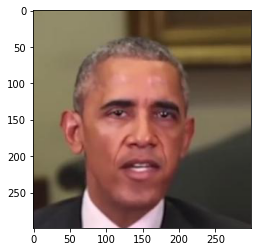

In [ ]:
import matplotlib.pyplot as plt
for i, img in enumerate(list(f'{source}_{num}.jpg' for num in range(using[source][0], using[source][1]))):
    plt.imshow(imread(os.path.join(folder, img)))
    print('Probability:', p[i].item())  # the probability of being manipulated
    plt.show()